<a href="https://colab.research.google.com/github/DanielGrass/ABInBev/blob/main/Technical_Test_AB_InBev.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# AB InBev - Technical Test
# Data Scientist
# Presentado por: Msc. Daniel Grass

## 1. Credit Scoring Model Challenge (Supervised Learning)

**Description**

> Banks and entities that give out credit play a crucial role in market economies. They decide who can be financed, on what terms and this can make or break investment decisions. For markets and society to function, individuals and companies need access to credit.
Credit scoring algorithms, which make a guess at the probability of default, are the method banks and entities use to determine whether or not a loan should be granted. This challenge requires participants to improve on the state of the art in credit scoring, by predicting the probability that somebody will be credit worthy by first predicting the probability that a client will experience financial distress in the next quarter. Historical data are provided on 250,000 borrowers.
The goal of this challenge is to build a model that lenders can use to help make the best financial decisions from a credit risk perspective.




In [1]:
!pip install fitter
!pip install plotly

In [2]:
import pandas as pd
import plotly.express as px
from fitter import Fitter, get_common_distributions
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go

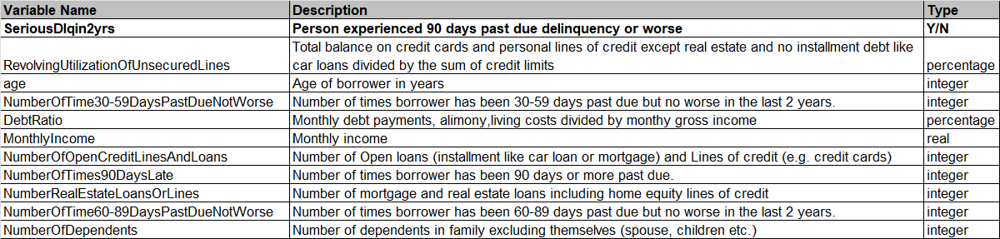

### 1.0 Load Data


> Given Inputs
*   **data_dictionary.xlsx**: Brief description of the variables that are available
for the challenge.
*   **cs-training.csv** and **cs-test.csv**: Database with all the available business variables.
  -  Use the target variable SeriousDlqin2yrs, already included in the dataset.
  -  Proceed with any feature engineering to build any variables you consider important for the challenge.
* **sample_results.csv**: Database with a sample of the credit scoring model results for clients in the training database.

In [3]:
#Ponemos las URLs de los archivos
url_cs_test = 'https://raw.githubusercontent.com/DanielGrass/ABInBev/main/data/cs-test.csv'
url_cs_training = 'https://raw.githubusercontent.com/DanielGrass/ABInBev/main/data/cs-training.csv'
url_cs_sample_result = 'https://raw.githubusercontent.com/DanielGrass/ABInBev/main/data/sample_results.csv'

# Carga los archivo CSV en un DataFrame
df_cs_training = pd.read_csv(url_cs_training)
df_cs_training = df_cs_training.drop(columns=['Unnamed: 0'])
df_cs_test = pd.read_csv(url_cs_test)
df_cs_test = df_cs_test.drop(columns=['Unnamed: 0'])
df_cs_sample_result = pd.read_csv(url_cs_sample_result)

In [4]:
def null_analysis(df):
    # Crear un DataFrame con la información de calidad de datos para cada columna
    data_quality = {
        "Columna": [],
        "Cantidad Nulls": [],
        "Lenght": [],
        "Valores únicos": [],
        "Tipo de datos": [],
        "Valor mínimo": [],
        "Valor máximo": [],
    }

    # Iterar por cada columna del DataFrame original
    for col in df.columns:
        data_quality["Columna"].append(col)
        data_quality["Lenght"].append(len(df))
        data_quality["Cantidad Nulls"].append(df[col].isnull().sum())
        data_quality["Valores únicos"].append(df[col].nunique())
        data_quality["Tipo de datos"].append(df[col].dtype)
        if df[col].dtype in ('float64', 'int64'):
            data_quality["Valor mínimo"].append(df[col].min())
            data_quality["Valor máximo"].append(df[col].max())
        else:
            data_quality["Valor mínimo"].append(0)
            data_quality["Valor máximo"].append(0)


    # Convertir el diccionario en un DataFrame
    quality_df = pd.DataFrame(data_quality)
    display(quality_df)

In [5]:
null_analysis(df_cs_training)

,Columna,Cantidad Nulls,Lenght,Valores únicos,Tipo de datos,Valor mínimo,Valor máximo
0,SeriousDlqin2yrs,0,150000,2,int64,0.0,1.0
1,RevolvingUtilizationOfUnsecuredLines,0,150000,125728,float64,0.0,50708.0
2,age,0,150000,86,int64,0.0,109.0
3,NumberOfTime30-59DaysPastDueNotWorse,0,150000,16,int64,0.0,98.0
4,DebtRatio,0,150000,114194,float64,0.0,329664.0
5,MonthlyIncome,29731,150000,13594,float64,0.0,3008750.0
6,NumberOfOpenCreditLinesAndLoans,0,150000,58,int64,0.0,58.0
7,NumberOfTimes90DaysLate,0,150000,19,int64,0.0,98.0
8,NumberRealEstateLoansOrLines,0,150000,28,int64,0.0,54.0
9,NumberOfTime60-89DaysPastDueNotWorse,0,150000,13,int64,0.0,98.0


**Data Completeness and Quality Issues:** The columns MonthlyIncome and NumberOfDependents have significant missing values, which represent a notable portion of the dataset. Specifically, MonthlyIncome has 29,731 missing values, accounting for 19.82% of the total data, while NumberOfDependents has 3,924 missing values, representing 2.62% of the total. These missing values can substantially impact the performance of predictive models or clustering results. Addressing these gaps through imputation or other data preprocessing techniques is crucial for ensuring accurate and reliable insights.

**Feature Variability and Data Range:** The dataset exhibits wide variability across several features, such as RevolvingUtilizationOfUnsecuredLines (ranging from 0 to 50,708) and MonthlyIncome (ranging from 0 to 3,008,750). This indicates a broad spectrum of financial profiles among clients. Moderate ranges in features like age and various delinquency metrics suggest diverse behavioral and demographic characteristics. Proper scaling, handling of outliers, and careful treatment of missing values are essential to enhance the modeling and clustering effectiveness.

### 1.1 EDA

In [8]:
def plot_distribution_with_outlier_removal(column, df, remove_outliers=True):
    # Visualización inicial de la distribución
    fig_hist = px.histogram(df, x=column, nbins=50, title=f"Histogram of {column} (Original)", marginal="box")
    fig_hist.show()

    # Eliminación de outliers si remove_outliers es True
    if remove_outliers:
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
        # Visualización de la distribución sin outliers
        fig_hist_no_outliers = px.histogram(df, x=column, nbins=50, title=f"Histogram of {column} (Without Outliers)", marginal="box")
        fig_hist_no_outliers.show()

    # Selección de distribuciones según el tipo de dato
    distributions = get_common_distributions() + ['beta', 'uniform', 'triang'+'lognorm']

    # Ajustar las distribuciones seleccionadas
    f = Fitter(df[column].dropna(), distributions=distributions)

    # Ajustar las distribuciones
    f.fit()
    best_fit = f.get_best(method='sumsquare_error')

    # Mostrar el mejor ajuste encontrado y sus parámetros
    best_distribution = list(best_fit.keys())[0]
    best_params = best_fit[best_distribution]
    print(f"Best fit for `{column}`: {best_distribution}")
    print(f"Best fit parameters: {best_params}")

    # Mostrar el resumen de los ajustes
    fig = plt.figure(figsize=(10, 5))
    f.summary()  # Generar y mostrar el gráfico del ajuste
    plt.show()  # Mostrar el gráfico

In [9]:
def plot_categorical_distribution_with_pareto(column_name, data, color):
            # Contar las ocurrencias de cada categoría y calcular el porcentaje acumulado
            category_counts = data[column_name].value_counts()
            category_percent = 100 * category_counts.cumsum() / category_counts.sum()

            # Crear el gráfico de barras
            fig = go.Figure()

            # Agregar barras
            fig.add_trace(go.Bar(
                x=category_counts.index,
                y=category_counts.values,
                marker_color=color,
                name='Frecuencia',
                yaxis='y1'
            ))

            # Agregar la línea de Pareto en un eje secundario
            fig.add_trace(go.Scatter(
                x=category_counts.index,
                y=category_percent,
                mode='lines+markers',
                name='% Acumulado',
                line=dict(color='red', dash='dash'),
                marker=dict(color='red'),
                yaxis='y2'
            ))

            # Configuración de los ejes y título
            fig.update_layout(
                title=f"Distribución de {column_name.capitalize()} y Línea de Pareto",
                xaxis_title=column_name.capitalize(),
                yaxis=dict(title='Frecuencia', side='left', showgrid=False),
                yaxis2=dict(title='% Acumulado', side='right', overlaying='y', range=[0, 100], showgrid=False),
                template="plotly_white"
            )

            # Mostrar el gráfico en Streamlit
            fig.show()

Best fit for `RevolvingUtilizationOfUnsecuredLines`: gamma
Best fit parameters: {'a': 0.676194333414418, 'loc': -1.623432331268474e-29, 'scale': 0.23506480887922626}


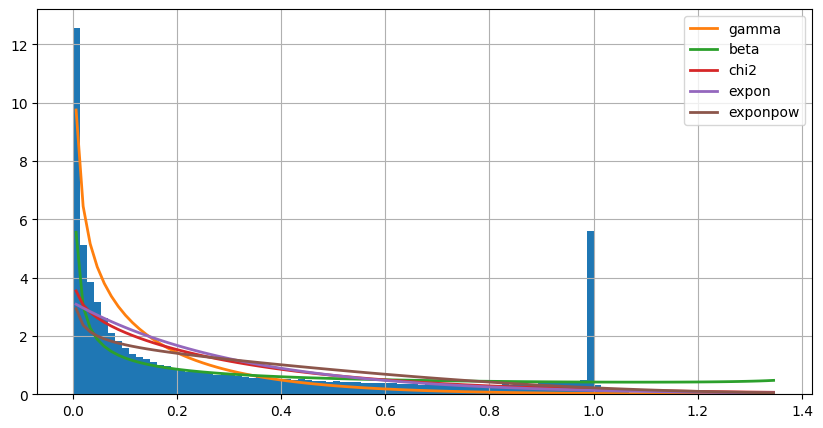

In [10]:
plot_distribution_with_outlier_removal('RevolvingUtilizationOfUnsecuredLines', df_cs_training, True)

Best fit for `age`: beta
Best fit parameters: {'a': 2.531830016225189, 'b': 3.564630687191446, 'loc': 18.92789289120653, 'scale': 80.21987018688986}


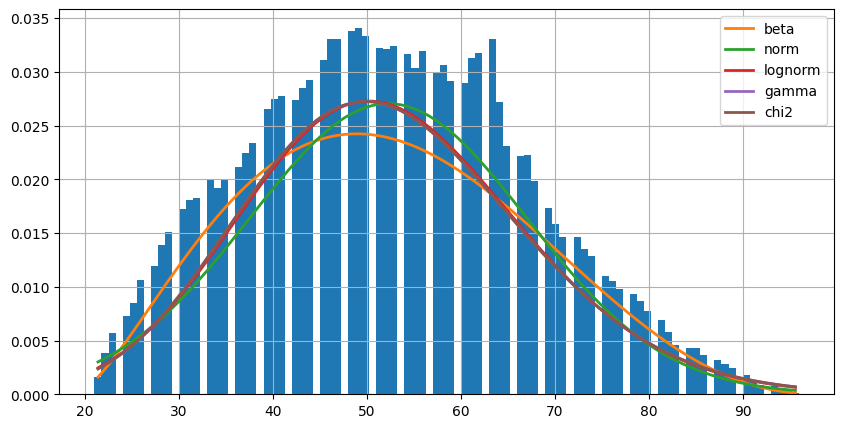

In [11]:
plot_distribution_with_outlier_removal('age', df_cs_training, True)

Best fit for `NumberOfTime30-59DaysPastDueNotWorse`: expon
Best fit parameters: {'loc': 0.0, 'scale': 0.4210333333333333}


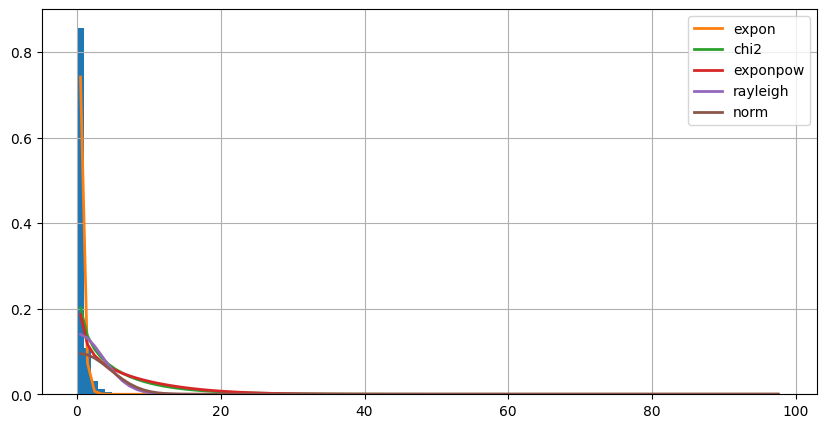

In [59]:
plot_distribution_with_outlier_removal('NumberOfTime30-59DaysPastDueNotWorse', df_cs_training, False)

Best fit for `DebtRatio`: exponpow
Best fit parameters: {'b': 0.5840889160957657, 'loc': -7.937960695629595e-30, 'scale': 0.5121916278508811}


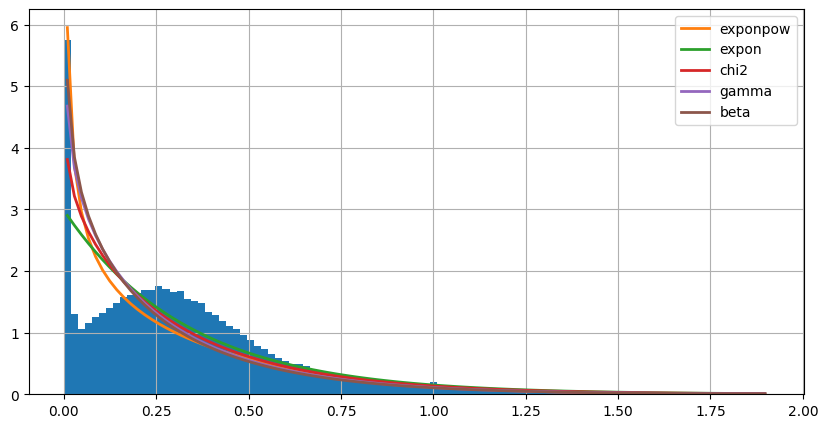

In [13]:
plot_distribution_with_outlier_removal('DebtRatio', df_cs_training, True)

Best fit for `MonthlyIncome`: gamma
Best fit parameters: {'a': 5.201040195580335, 'loc': -1831.7882298002933, 'scale': 1459.9867320917376}


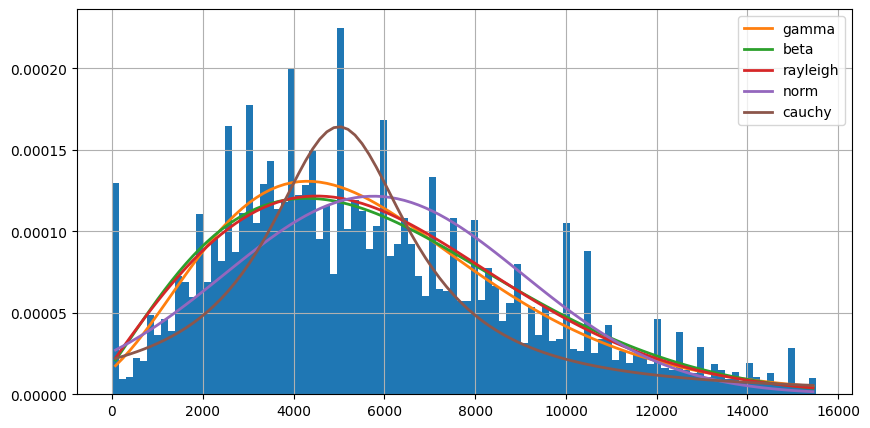

In [14]:
plot_distribution_with_outlier_removal('MonthlyIncome', df_cs_training, True)

Best fit for `NumberOfOpenCreditLinesAndLoans`: chi2
Best fit parameters: {'df': 12.454553057885775, 'loc': -3.133934892006897, 'scale': 0.894744977340604}


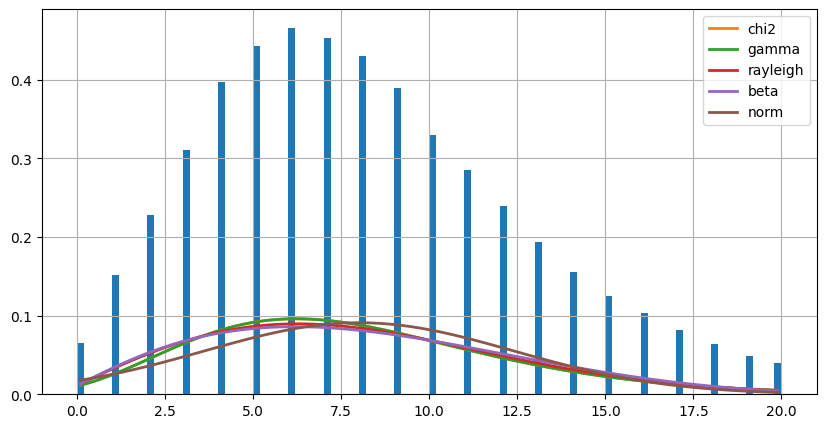

In [15]:
plot_distribution_with_outlier_removal('NumberOfOpenCreditLinesAndLoans', df_cs_training, True)

Best fit for `NumberOfTimes90DaysLate`: expon
Best fit parameters: {'loc': 0.0, 'scale': 0.26597333333333334}


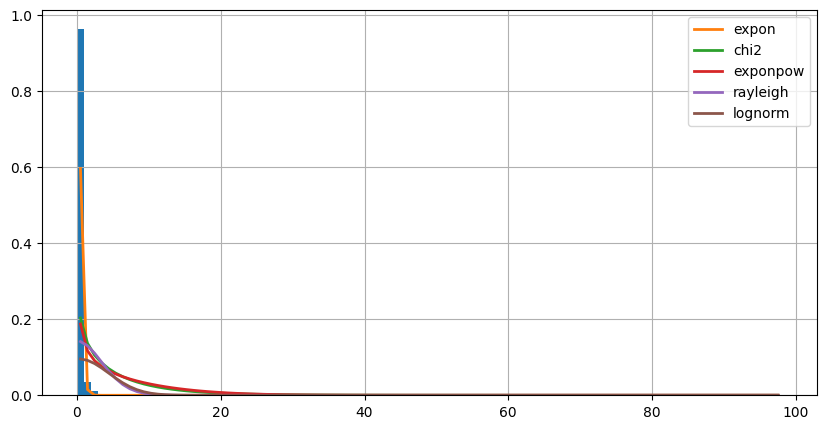

In [16]:
plot_distribution_with_outlier_removal('NumberOfTimes90DaysLate', df_cs_training, False)

Best fit for `NumberRealEstateLoansOrLines`: gamma
Best fit parameters: {'a': 0.22779961788705597, 'loc': -2.1937113396152335e-29, 'scale': 0.8802730553740232}


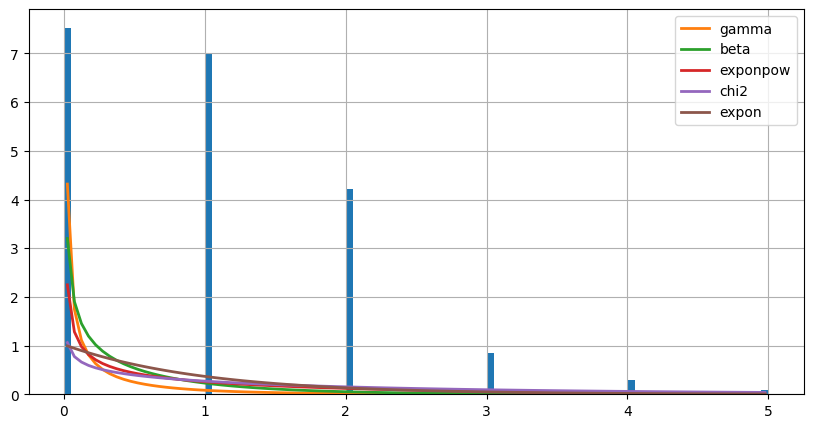

In [17]:
plot_distribution_with_outlier_removal('NumberRealEstateLoansOrLines', df_cs_training, True)

Best fit for `NumberOfTime60-89DaysPastDueNotWorse`: expon
Best fit parameters: {'loc': 0.0, 'scale': 0.24038666666666667}


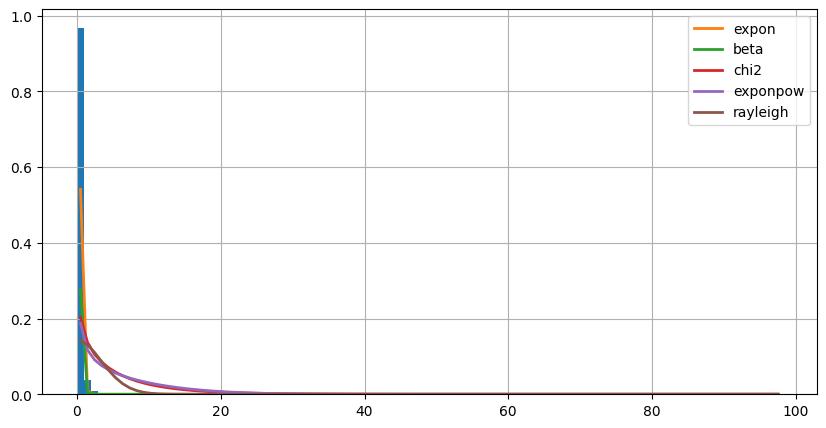

In [18]:
plot_distribution_with_outlier_removal('NumberOfTime60-89DaysPastDueNotWorse', df_cs_training, False)

Best fit for `NumberOfDependents`: chi2
Best fit parameters: {'df': 0.8625131669788966, 'loc': -3.2528133557673045e-30, 'scale': 1.0550410666258934}


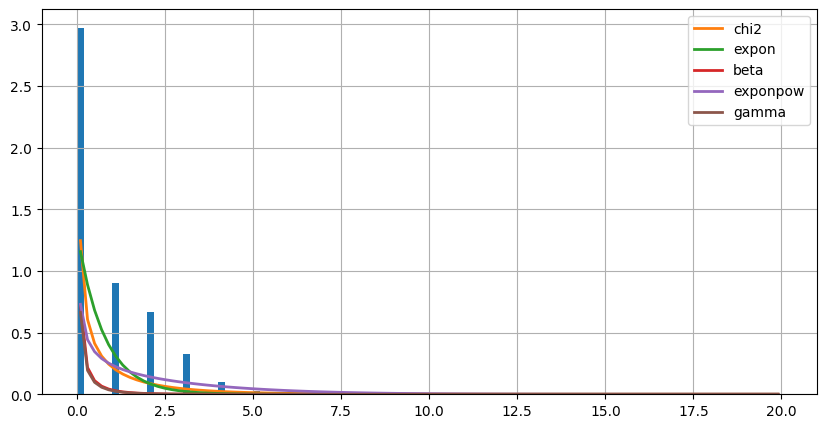

In [19]:
plot_distribution_with_outlier_removal('NumberOfDependents', df_cs_training, False)

**Identification of Best-Fitting Distributions:** Each feature in the dataset was analyzed to find the best-fitting statistical distribution, which would be useful for generating synthetic data or simulations if needed. For example, RevolvingUtilizationOfUnsecuredLines fits best with a gamma distribution, while age fits a beta distribution. Understanding these distributions helps in accurately modeling the data's behavior, especially when creating random variables for simulations.

**Potential Use of Exponential and Gamma Distributions:** Several features, such as NumberOfTime30-59DaysPastDueNotWorse, NumberOfTimes90DaysLate, and NumberOfTime60-89DaysPastDueNotWorse, were found to fit well with exponential distributions, indicating these variables describe events with decaying probabilities. The MonthlyIncome, fitting a gamma distribution, reflects a typical skewed income pattern seen in financial data.

**Zero-Inflated Possibility for DebtRatio:** The DebtRatio best fits an exponential power distribution, which suggests that it may also be a candidate for a zero-inflated Poisson model due to the possible presence of many zeros or extremely low values. This indicates that many individuals might have little to no debt burden relative to income, interspersed with occasional higher ratios, highlighting the importance of recognizing zero inflation when simulating or modeling this variable.

**Handling of Outliers Using Interquartile Range:** Outliers were removed using the interquartile range method, enhancing the accuracy of the distribution fits and ensuring that simulations or synthetic data generated will be more representative of the cleaned dataset. This step was critical for improving the reliability of statistical modeling and the quality of data-driven insights.

In [20]:
plot_categorical_distribution_with_pareto('SeriousDlqin2yrs', df_cs_training, 'green')

**Class Imbalance in SeriousDlqin2yrs:** Approximately 97% of the training data belong to class 0 (no severe delinquency in the past two years), while only about 3% belong to class 1 (severe delinquency). This significant imbalance can impact the performance of predictive models, particularly if not properly addressed with techniques such as class balancing (e.g., SMOTE, resampling) or adjusting model weights to account for the disproportion.

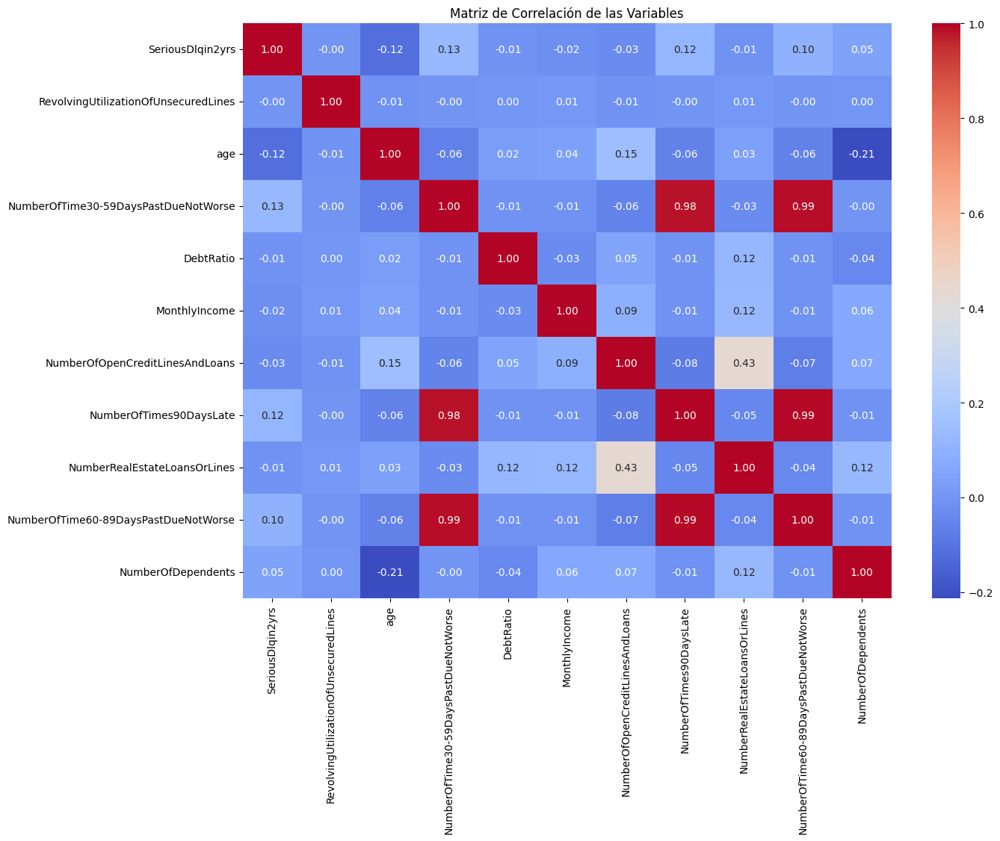

In [23]:
# Eliminar la columna 'Unnamed: 0' que no aporta valor
training_data = df_cs_training.copy()

# Calcular la matriz de correlación
correlation_matrix = training_data.corr()

# Visualización de la matriz de correlación
plt.figure(figsize=(14, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', cbar=True)
plt.title('Matriz de Correlación de las Variables')
plt.show()

*   NumberOfTime60-89DaysPastDueNotWorse have very high correlations with each other (close to 0.98-0.99). This indicates that these variables are highly related and may be capturing similar information about the client's delinquency. In a model, this can lead to redundancy and multicollinearity, which could affect the interpretation of coefficients in linear models.
*   RevolvingUtilizationOfUnsecuredLines, age, DebtRatio, MonthlyIncome, NumberOfOpenCreditLinesAndLoans, NumberRealEstateLoansOrLines, and NumberOfDependents have low correlations with the target variable, all close to 0. This indicates that individually, these variables are not strong predictors of severe delinquency, although they might still be useful in combination with other variables.








### 1.2 Credit Scoring Model - RandomForestClassifier and XGBClassifier

In [25]:
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score, classification_report, confusion_matrix, roc_curve
from imblearn.over_sampling import SMOTE
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from xgboost import XGBClassifier
import plotly.graph_objects as go

# Preparación de los datos de entrenamiento
df_train = df_cs_training.copy()

# Feature Engineering
# 1. Total Number of Late Payments
df_train['TotalLatePayments'] = (
    df_train['NumberOfTime30-59DaysPastDueNotWorse'] +
    df_train['NumberOfTimes90DaysLate'] +
    df_train['NumberOfTime60-89DaysPastDueNotWorse']
)
# 2. Age Binned - Agrupar edades en categorías

df_train['AgeBinned'] = pd.cut(df_train['age'], bins=[0, 25, 40, 55, 70, 120],
                               labels=['Young', 'Adult', 'Middle-Aged', 'Senior', 'Elderly'])
df_train['AgeBinned'] = df_train['AgeBinned'].cat.add_categories('Unknown').fillna('Unknown')
age_mapping = {'Young': 0, 'Adult': 1, 'Middle-Aged': 2, 'Senior': 3, 'Elderly': 4, 'Unknown': 5}
df_train['AgeBinnedEncoded'] = df_train['AgeBinned'].map(age_mapping).astype(float)

# Separar características y la variable objetivo
X_train = df_train.drop(['SeriousDlqin2yrs', 'AgeBinned', 'age', 'NumberOfTime30-59DaysPastDueNotWorse', 'NumberOfTimes90DaysLate', 'NumberOfTime60-89DaysPastDueNotWorse'], axis=1)
y_train = df_train['SeriousDlqin2yrs']

# Pipeline de imputación
pipeline = Pipeline(steps=[('imputer', SimpleImputer(strategy='median'))])
X_train = pd.DataFrame(pipeline.fit_transform(X_train), columns=X_train.columns)

# Aplicar SMOTE
smote = SMOTE(random_state=42)
X_train_balanced, y_train_balanced = smote.fit_resample(X_train, y_train)

# Entrenar y evaluar Random Forest
rf_model = RandomForestClassifier(n_estimators=100, random_state=42, max_depth=20, min_samples_split = 5, class_weight='balanced')
rf_model.fit(X_train_balanced, y_train_balanced)


# Entrenar y evaluar XGBoost
xgb_model = XGBClassifier(n_estimators=100, random_state=42, scale_pos_weight=len(y_train_balanced[y_train_balanced == 0]) / len(y_train_balanced[y_train_balanced == 1]), use_label_encoder=False, eval_metric='logloss')
xgb_model.fit(X_train_balanced, y_train_balanced)

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning:

[01:06:01] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.




XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric='logloss',
              feature_types=None, gamma=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=100,
              n_jobs=None, num_parallel_tree=None, random_state=42, ...)

In [26]:
# Función para evaluar un modelo y obtener los valores para la gráfica ROC-AUC
def evaluate_model(y_true, y_pred_proba, model_name, threshold=0.2):
    # Convertir las probabilidades en predicciones binarias usando el umbral dado
    y_pred = (y_pred_proba >= threshold).astype(int)

    # Mostrar la matriz de confusión y el reporte de clasificación
    print(f"Matriz de Confusión - {model_name}:")
    print(confusion_matrix(y_true, y_pred))

    print(f"\nReporte de Clasificación - {model_name}:")
    print(classification_report(y_true, y_pred))

    print(f"\nCantidad de labels que no coincidieron - {model_name}:")
    print((abs(y_true - y_pred)).sum())

    # Calcular el AUC-ROC y las curvas ROC
    roc_auc = roc_auc_score(y_true, y_pred_proba)
    fpr, tpr, thresholds = roc_curve(y_true, y_pred_proba)

    return fpr, tpr, roc_auc

# Evaluar modelos y obtener los valores de ROC-AUC
fpr_rf, tpr_rf, auc_rf = evaluate_model(y_train, rf_model.predict_proba(X_train)[:, 1], "Random Forest")
fpr_xgb, tpr_xgb, auc_xgb = evaluate_model(y_train, xgb_model.predict_proba(X_train)[:, 1], "XGBoost")

# Crear una gráfica ROC-AUC combinada usando Plotly
fig = go.Figure()

# Añadir la curva ROC de Random Forest
fig.add_trace(go.Scatter(x=fpr_rf, y=tpr_rf, mode='lines', name=f'ROC Curve - Random Forest (AUC = {auc_rf:.2f})'))

# Añadir la curva ROC de XGBoost
fig.add_trace(go.Scatter(x=fpr_xgb, y=tpr_xgb, mode='lines', name=f'ROC Curve - XGBoost (AUC = {auc_xgb:.2f})'))

# Añadir la línea de referencia diagonal
fig.add_trace(go.Scatter(x=[0, 1], y=[0, 1], mode='lines', name='Random Guess', line=dict(dash='dash')))

# Configurar el diseño de la gráfica
fig.update_layout(
    title='Comparative ROC-AUC Curve: Random Forest vs. XGBoost',
    xaxis_title='False Positive Rate (FPR)',
    yaxis_title='True Positive Rate (TPR)',
    showlegend=True,
    template='plotly_white'
)

# Mostrar la gráfica
fig.show()


Matriz de Confusión - Random Forest:
[[129501  10473]
 [    50   9976]]

Reporte de Clasificación - Random Forest:
              precision    recall  f1-score   support

           0       1.00      0.93      0.96    139974
           1       0.49      1.00      0.65     10026

    accuracy                           0.93    150000
   macro avg       0.74      0.96      0.81    150000
weighted avg       0.97      0.93      0.94    150000


Cantidad de labels que no coincidieron - Random Forest:
10523
Matriz de Confusión - XGBoost:
[[129450  10524]
 [  3777   6249]]

Reporte de Clasificación - XGBoost:
              precision    recall  f1-score   support

           0       0.97      0.92      0.95    139974
           1       0.37      0.62      0.47     10026

    accuracy                           0.90    150000
   macro avg       0.67      0.77      0.71    150000
weighted avg       0.93      0.90      0.92    150000


Cantidad de labels que no coincidieron - XGBoost:
14301


**Performance Comparison:** The Random Forest model outperformed XGBoost in overall accuracy and F1-score, particularly for the minority class (1). Random Forest achieved an accuracy of 93% and a macro average F1-score of 81%, while XGBoost had an accuracy of 90% and a macro average F1-score of 77%. This indicates that Random Forest is better at correctly classifying both classes, especially in distinguishing severe delinquency cases (class 1) with a higher recall of 100% compared to XGBoost's 62%.

**Class Imbalance Handling:** Both models showed high precision for class 0 (non-delinquent), with near-perfect scores, but struggled more with class 1 (delinquent), which is expected given the severe class imbalance. However, Random Forest managed to achieve a balanced recall of 100% for class 1 due to the lower threshold set at 0.2, which improved its sensitivity towards the minority class. This shows the impact of adjusting the threshold on the model’s performance.

In [30]:
# Función para preparar los datos de prueba y evaluar ambos modelos en la misma gráfica
def prepare_and_compare(df_test, rf_model, xgb_model, y_test_sample_result, pipeline, threshold=0.2):
    # Añadir las mismas características al conjunto de prueba
    df_test['TotalLatePayments'] = (
        df_test['NumberOfTime30-59DaysPastDueNotWorse'] +
        df_test['NumberOfTimes90DaysLate'] +
        df_test['NumberOfTime60-89DaysPastDueNotWorse']
    )
    df_test['AgeBinned'] = pd.cut(df_test['age'], bins=[0, 25, 40, 55, 70, 120],
                                  labels=['Young', 'Adult', 'Middle-Aged', 'Senior', 'Elderly'])
    df_test['AgeBinned'] = df_test['AgeBinned'].cat.add_categories('Unknown').fillna('Unknown')
    df_test['AgeBinnedEncoded'] = df_test['AgeBinned'].map(age_mapping).astype(float)

    # Aplicar imputación al conjunto de prueba usando el pipeline ajustado
    X_test = pd.DataFrame(pipeline.transform(df_test.drop(['SeriousDlqin2yrs', 'AgeBinned',  'age', 'NumberOfTime30-59DaysPastDueNotWorse', 'NumberOfTimes90DaysLate', 'NumberOfTime60-89DaysPastDueNotWorse'], axis=1)),
                          columns=df_test.drop(['SeriousDlqin2yrs', 'AgeBinned',  'age', 'NumberOfTime30-59DaysPastDueNotWorse', 'NumberOfTimes90DaysLate', 'NumberOfTime60-89DaysPastDueNotWorse'], axis=1).columns)

    # Predecir probabilidades en el conjunto de prueba con Random Forest
    y_pred_proba_rf = rf_model.predict_proba(X_test)[:, 1]
    fpr_rf, tpr_rf, auc_rf = evaluate_model(y_test_sample_result, y_pred_proba_rf, "Random Forest", threshold)

    # Predecir probabilidades en el conjunto de prueba con XGBoost
    y_pred_proba_xgb = xgb_model.predict_proba(X_test)[:, 1]
    fpr_xgb, tpr_xgb, auc_xgb = evaluate_model(y_test_sample_result, y_pred_proba_xgb, "XGBoost", threshold)

    # Crear una gráfica ROC-AUC combinada usando Plotly
    fig = go.Figure()

    # Añadir la curva ROC de Random Forest
    fig.add_trace(go.Scatter(x=fpr_rf, y=tpr_rf, mode='lines', name=f'ROC Curve - Random Forest (AUC = {auc_rf:.2f})'))

    # Añadir la curva ROC de XGBoost
    fig.add_trace(go.Scatter(x=fpr_xgb, y=tpr_xgb, mode='lines', name=f'ROC Curve - XGBoost (AUC = {auc_xgb:.2f})'))

    # Añadir la línea de referencia diagonal
    fig.add_trace(go.Scatter(x=[0, 1], y=[0, 1], mode='lines', name='Random Guess', line=dict(dash='dash')))

    # Configurar el diseño de la gráfica
    fig.update_layout(
        title='Comparative ROC-AUC Curve: Random Forest vs. XGBoost on Test Set',
        xaxis_title='False Positive Rate (FPR)',
        yaxis_title='True Positive Rate (TPR)',
        showlegend=True,
        template='plotly_white'
    )

    # Mostrar la gráfica
    fig.show()

threshold = 0.2
# Trae las probabilidades de cs_sample_result y las covierte 0 a 1 dependiendo el threshold
y_test_sample_result = (df_cs_sample_result['Probability'] >= threshold).astype(int)

# Preparar y comparar Random Forest y XGBoost en el conjunto de prueba
prepare_and_compare(df_cs_test.copy(), rf_model, xgb_model, y_test_sample_result, pipeline, threshold)


Matriz de Confusión - Random Forest:
[[85241  7044]
 [  595  8623]]

Reporte de Clasificación - Random Forest:
              precision    recall  f1-score   support

           0       0.99      0.92      0.96     92285
           1       0.55      0.94      0.69      9218

    accuracy                           0.92    101503
   macro avg       0.77      0.93      0.83    101503
weighted avg       0.95      0.92      0.93    101503


Cantidad de labels que no coincidieron - Random Forest:
7639
Matriz de Confusión - XGBoost:
[[88733  3552]
 [ 1310  7908]]

Reporte de Clasificación - XGBoost:
              precision    recall  f1-score   support

           0       0.99      0.96      0.97     92285
           1       0.69      0.86      0.76      9218

    accuracy                           0.95    101503
   macro avg       0.84      0.91      0.87    101503
weighted avg       0.96      0.95      0.95    101503


Cantidad de labels que no coincidieron - XGBoost:
4862


* **Performance Consistency:** Both Random Forest and XGBoost maintained good overall accuracy on the test set, with Random Forest achieving 92% and XGBoost slightly lower at 91%. Random Forest demonstrated better consistency in recall for class 1 (delinquent cases), achieving 94% compared to XGBoost's 86%. This indicates that Random Forest's sensitivity towards severe delinquency cases remains robust, even on unseen data.

* **Class 1 (Delinquent) Detection:** Random Forest showed a better balance between precision and recall for class 1, with an F1-score of 74% compared to XGBoost’s 76%. Despite having slightly lower precision (55%), Random Forest's higher recall indicates it is better at correctly identifying delinquent cases, which is crucial in high-stakes financial decisions where missing true positives can be costly.

* **Mismatch and Model Stability:** XGBoost had significantly fewer mismatches (4,862) compared to Random Forest (7,639), suggesting it might be less prone to overfitting compared to Random Forest. This lower mismatch count implies that XGBoost may provide more stable predictions under different data conditions, making it a strong alternative if the goal is to reduce the number of incorrect predictions, especially for the majority class. However, Random Forest still excels in detecting minority cases.

**Questionnaire:**
1. Briefly describe how you would build the target variable if it were not available in the dataset.

   **Solution:** To build the target variable if it were not available in the dataset, one approach would be to define business rules based on domain expertise and historical data patterns. For instance, you could set thresholds or conditions based on past due payments, credit utilization, or other key financial indicators to classify clients into categories such as "delinquent" (1) or "non-delinquent" (0).

  If defining business rules is not feasible or accurate enough, an unsupervised learning approach, such as clustering algorithms (e.g., K-means or DBSCAN), could be used to group clients with similar behaviors. These clusters could then be analyzed to determine which groups represent higher risk (1) and which represent lower risk (0), effectively allowing the model to classify clients into target categories without explicit labels. This hybrid approach leverages both expert knowledge and data-driven insights to approximate the target variable.
2. What metrics do you consider relevant to consider in the decision of choosing the best model? Discuss why you might give priority to one metric over another.

   **Solution:** Given the context of credit scoring and the imbalanced nature of the target variable (delinquency vs. non-delinquency), Recall and F1-Score are often prioritized. Recall is critical because missing a high-risk client could lead to significant financial loss, while the F1-Score provides a balanced view of precision and recall, ensuring the model does not favor one metric at the expense of the other. AUC-ROC is also important as it provides insight into the model's overall discriminative ability, particularly valuable for evaluating threshold performance adjustments.
3. In the metric optimization process, how may the cutoff point or threshold of the prediction of the probability of default affect the result?
   
   **Solution:**
   - Lowering the Threshold increases recall but reduces precision, making the model more sensitive to identifying defaulters at the expense of more false positives. This is useful when missing a defaulter is riskier than misclassifying a non-defaulter.
   - Raising the Threshold increases precision but lowers recall, making the model stricter and reducing false positives. This approach is beneficial when the cost of false positives is high, but it risks missing actual defaulters.

4. What additional variables do you think should be considered given the context of our clients at AB InBev? (Bars, Restaurants, Convenience Stores, etc.)
  
  **Solution:**
  * **Order Frequency:** Measures how often the client places orders, indicating customer engagement and consistency in purchasing behavior. Higher frequency could correlate with customer loyalty and stability.

  * **Order Volume:** Reflects the size or quantity of orders, which can be indicative of the client’s business scale and purchasing power. Analyzing volume trends can help identify growing or declining accounts.

  * **Geographical Location:** Incorporates regional factors that may affect client behavior, such as local demand, competition, and market conditions. It’s crucial for tailoring regional sales strategies and understanding location-specific risks.

  * **Fraudulent Behavior in Internal Sales Applications:** Detects any suspicious activities or patterns that could indicate higher risk clients, such as manipulation of orders, payment inconsistencies, or other red flags within company sales apps.

  * **Access to Discounts:** Tracks whether the client regularly uses discounts, which could indicate price sensitivity or strategic purchasing behavior. This information is valuable for understanding client value and optimizing sales promotions.

## 2. Client Segmentation Challenge (Unsupervised Learning)

**Description**

> Understanding a company’s client basis is key to proceed with proper commercial strategy, logistics and technology project development.
Clustering algorithms, which associate clients based on their characteristics, are one of the methods banks and commercial entities use to understand common characteristics, find look-alikes and better establish what are the key differentiating factors amongst them.
The goal of this challenge is to build a segmentation of clients that decision makers can use to help understand customer basis and further develop any strategies that are aligned with the company’s interests.

In [63]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import plotly.graph_objects as go

# Preprocesamiento de Datos: Cargar y preparar los datos de entrenamiento
df_train = X_train.copy()

# Seleccionar las características relevantes para K-means
features = [
    'RevolvingUtilizationOfUnsecuredLines', 'DebtRatio',
    'MonthlyIncome', 'NumberOfOpenCreditLinesAndLoans', 'NumberRealEstateLoansOrLines',
    'NumberOfDependents', 'TotalLatePayments'
]

# Limpiar datos y manejar valores faltantes
df_train = df_train[features].dropna()

# Escalar los datos
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_train)

# Determinación del Número Óptimo de Clusters usando Elbow Method y Silhouette Test
wcss = []
silhouette_scores = []
k_range = range(2, 6)

# Aplicar muestreo una vez antes de ajustar K-means
np.random.seed(42)
sample_size = 0.2
df_sample = df_scaled[np.random.choice(df_scaled.shape[0], int(df_scaled.shape[0] * sample_size), replace=False)]

for k in k_range:
    print(f"Evaluando K = {k}")
    # Ajustar K-means en el subconjunto muestreado
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df_sample)

    # Guardar la inercia para el método del codo
    wcss.append(kmeans.inertia_)

    # Calcular el puntaje de silueta usando las etiquetas del modelo ajustado sobre el subconjunto
    silhouette_avg = silhouette_score(df_sample, kmeans.labels_)
    silhouette_scores.append((k, silhouette_avg))
    print(f'Silhouette Score for K = {k}: {silhouette_avg}')

# Gráfica del método del codo
fig = go.Figure()
fig.add_trace(go.Scatter(x=list(k_range), y=wcss, mode='lines+markers', name='Elbow Method'))
fig.update_layout(
    title='Elbow Method for Optimal K',
    xaxis_title='Number of Clusters (K)',
    yaxis_title='Within-Cluster Sum of Squares (WCSS)',
    template='plotly_white'
)
fig.show()



Evaluando K = 2


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Silhouette Score for K = 2: 0.9017268022938433
Evaluando K = 3


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Silhouette Score for K = 3: 0.3111129641885356
Evaluando K = 4


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Silhouette Score for K = 4: 0.31153530197516166
Evaluando K = 5


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Silhouette Score for K = 5: 0.31211083008426965


In [67]:
# Gráfica del puntaje de silueta
# Extraer valores de K y puntajes de silueta para la gráfica
k_values, silhouette_values = zip(*silhouette_scores)

# Crear la gráfica de puntaje de Silueta
fig = go.Figure()
fig.add_trace(go.Scatter(x=k_values, y=silhouette_values, mode='lines+markers', name='Silhouette Score'))
fig.update_layout(
    title='Silhouette Score for Different K',
    xaxis_title='Number of Clusters (K)',
    yaxis_title='Silhouette Score',
    template='plotly_white'
)

# Mostrar la gráfica
fig.show()

# Determinar el número óptimo de clusters basado en el Test de Silueta
optimal_k = silhouette_scores.index(max(silhouette_scores))
print(f'Optimal number of clusters based on Silhouette Score: {optimal_k}')

# Aplicar K-means con el número óptimo de clusters
kmeans_optimal = KMeans(n_clusters=optimal_k, random_state=42)
df_train['Cluster'] = kmeans_optimal.fit_predict(df_scaled)

# Visualización de los clusters en 2D si tienes dos dimensiones principales
fig = go.Figure()
for cluster in range(optimal_k):
    cluster_data = df_train[df_train['Cluster'] == cluster]
    fig.add_trace(go.Scatter(x=cluster_data.iloc[:, 0], y=cluster_data.iloc[:, 1],
                             mode='markers', name=f'Cluster {cluster}'))


Optimal number of clusters based on Silhouette Score: 3


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



In [71]:
# Selección de tres características para la visualización 3D
feature_1 = 'RevolvingUtilizationOfUnsecuredLines'
feature_2 = 'DebtRatio'
feature_3 = 'MonthlyIncome'

# Crear una gráfica 3D de los clusters usando Plotly Express
fig = px.scatter_3d(
    df_train,
    x=feature_1,
    y=feature_2,
    z=feature_3,
    color='Cluster',
    title=f'Customer Segmentation with K-Means (K = {optimal_k})',
    labels={
        feature_1: feature_1,
        feature_2: feature_2,
        feature_3: feature_3
    }
)

# Configuración de la visualización
fig.update_layout(
    scene=dict(
        xaxis_title=feature_1,
        yaxis_title=feature_2,
        zaxis_title=feature_3
    ),
    template='plotly_white'
)

# Mostrar la gráfica
fig.show()

In [72]:
# Selección de tres características para la visualización 3D
feature_1 = 'NumberOfOpenCreditLinesAndLoans'
feature_2 = 'TotalLatePayments'
feature_3 = 'DebtRatio'


# Crear una gráfica 3D de los clusters usando Plotly Express
fig = px.scatter_3d(
    df_train,
    x=feature_1,
    y=feature_2,
    z=feature_3,
    color='Cluster',
    title=f'Customer Segmentation with K-Means (K = {optimal_k})',
    labels={
        feature_1: feature_1,
        feature_2: feature_2,
        feature_3: feature_3
    }
)

# Configuración de la visualización
fig.update_layout(
    scene=dict(
        xaxis_title=feature_1,
        yaxis_title=feature_2,
        zaxis_title=feature_3
    ),
    template='plotly_white'
)

# Mostrar la gráfica
fig.show()

**Questionnaire:**
1. Briefly explain the algorithms tested.

   **Solution:**

   * **K-Means Clustering:** K-Means is an unsupervised clustering algorithm that partitions the data into K clusters by minimizing the within-cluster sum of squares (WCSS). The algorithm iteratively assigns data points to the nearest cluster centroid and then recalculates the centroids until convergence.

   * **Elbow Method:** The Elbow Method is used to determine the optimal number of clusters by plotting the WCSS against the number of clusters. The optimal K is identified at the "elbow point" where adding more clusters provides diminishing returns in reducing WCSS.

   * **Silhouette Score:** The Silhouette Score measures how similar an object is to its own cluster compared to other clusters, ranging from -1 to 1. A higher score indicates better-defined and more distinct clusters.

2. Write a brief discussion on the process of selecting the proper number of groups..

   **Solution:**

   The Elbow Method helps identify the point where adding more clusters yields diminishing returns on reducing the Within-Cluster Sum of Squares (WCSS), but it sometimes lacks a clear "elbow," as seen in our analysis. The Silhouette Score evaluates cluster quality by measuring how well points are grouped within their clusters, with higher values indicating better-defined clusters. In our case, the Silhouette Score was highest for K=3. Ultimately, the combination of these methods helps balance the trade-off between cluster quality and the practicality of segmenting clients into an optimal number of groups.
3. Provide a brief interpretation of the clusters formed.
   
   **Solution:**


## 3.Concepts and understanding
Analyze and respond the following questions to the best of your understanding:
1. Briefly discuss any ML Ops standards you’ve been exposed to or are familiar with based on your understanding and experience.

**Solution:**
Based on my experience, I have been exposed to several MLOps standards, particularly within the Databricks and Apache Airflow ecosystems. In Databricks, I created and managed jobs for machine learning pipelines, ensuring that the models and data processing tasks were executed efficiently. I integrated these jobs into Apache Airflow to manage task dependencies, define precedence, and set execution schedules (daily, weekly, or monthly) using cron expressions. This setup facilitated automated and reliable execution of notebooks, enhancing workflow management and enabling continuous integration and deployment of ML models.

2. In the development of a Machine Learning project with a business objective such as predicting sales, calculating propensity scores or recommending a product or service, what should the script structure of the project contain?

**Solution:**
 - data/: Contains raw data and processed data files.
 - notebooks/: Contains Jupyter or Databricks notebooks for exploratory data analysis (EDA), feature engineering, and preliminary modeling.
 - scripts/: Main folder for Python scripts, organized by functionality.
 - models/: Stores trained model files, serialized using formats like .pkl
 - requirements.txt: Lists all dependencies and libraries required to run the project.

3. Why is it of importance to think about the implementation and integration of an ML Project to a company’s system framework?

**Solution:** Implementing and integrating an ML project into a company’s system framework is crucial because it ensures the models are scalable, reliable, and aligned with existing business processes. Proper integration allows for seamless data flow, ongoing monitoring, and maintenance, ensuring models remain accurate and relevant over time. It also supports security and compliance, enhances operational efficiency, and ultimately drives business impact by turning insights into actionable decisions that improve KPIs and return on investment.

4. Do you have experience using cloud architectures? If so, please discuss which ones you’ve used. Are you familiar with the AzureML framework?

**Solution:** I am not familiar with AzureML, but I have experience with cloud architectures, particularly with AWS. In AWS, I worked with S3 for data storage, Apache Airflow for orchestration and workflow management, CodePipeline for continuous integration and deployment, and Lambda functions for serverless computing tasks. These tools enabled me to build scalable, automated data pipelines and deploy machine learning models efficiently within the cloud environment. Also I worked with Databricks.

5. Are you familiar with the Spark framework and have you developed any models using languages such as PySpark or Scala?

**Solution:** Yes, I am familiar with the Spark framework, particularly through my experience with Databricks using PySpark. I have developed several models and performed various ETL processes using PySpark. This experience allowed me to build and optimize data pipelines, clean and transform data, and implement machine learning models within the Spark environment.

| Concept                | Description                                                                                   | Example of Applicable Business Scenario                        |
|------------------------|-----------------------------------------------------------------------------------------------|---------------------------------------------------------------|
| Recommender Systems    | Algorithms that suggest products or content to users based on their preferences and behavior. | Online shopping recommending related products to customers.    |
| XGBoost                | A powerful gradient boosting algorithm known for its performance in classification and regression tasks. | Predicting customer churn in a telecommunications company.    |
| Cross-Validation       | A statistical method used to estimate the skill of a model on new data by partitioning the data into subsets. | Evaluating the performance of machine learning models.         |
| Silhouette Test        | A method used to evaluate the quality of clusters in clustering analysis by measuring how similar an object is to its own cluster compared to other clusters. | Assessing customer segmentation in marketing.                  |
| ROC Curve              | A graphical representation of a model’s diagnostic ability, showing the trade-off between true positive rate and false positive rate. | Evaluating the performance of a binary classification model.   |
| AUC Metric             | The Area Under the ROC Curve, measuring the model’s ability to distinguish between classes.   | Comparing the effectiveness of different credit scoring models.|
